In [3]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import glob
import json
import random

random.seed(1234)

import matplotlib.pyplot as plt
plt.style.use('ggplot')

root_path = '/kaggle/input/CORD-19-research-challenge/'
metadata_path = f'{root_path}/metadata.csv'
meta_df = pd.read_csv(metadata_path, dtype={
    'pubmed_id': str,
    'Microsoft Academic Paper ID': str, 
    'doi': str
})
meta_df.head()

/opt/conda/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3552: DtypeWarning: Columns (1,5,13,14,15,16) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


,cord_uid,sha,source_x,title,doi,pmcid,pubmed_id,license,abstract,publish_time,authors,journal,mag_id,who_covidence_id,arxiv_id,pdf_json_files,pmc_json_files,url,s2_id
0,ug7v899j,d1aafb70c066a2068b02786f8929fd9c900897fb,PMC,Clinical features of culture-proven Mycoplasma...,10.1186/1471-2334-1-6,PMC35282,11472636,no-cc,OBJECTIVE: This retrospective chart review des...,2001-07-04,"Madani, Tariq A; Al-Ghamdi, Aisha A",BMC Infect Dis,NaN,NaN,NaN,document_parses/pdf_json/d1aafb70c066a2068b027...,document_parses/pmc_json/PMC35282.xml.json,https://www.ncbi.nlm.nih.gov/pmc/articles/PMC3...,NaN
1,02tnwd4m,6b0567729c2143a66d737eb0a2f63f2dce2e5a7d,PMC,Nitric oxide: a pro-inflammatory mediator in l...,10.1186/rr14,PMC59543,11667967,no-cc,Inflammatory diseases of the respiratory tract...,2000-08-15,"Vliet, Albert van der; Eiserich, Jason P; Cros...",Respir Res,NaN,NaN,NaN,document_parses/pdf_json/6b0567729c2143a66d737...,document_parses/pmc_json/PMC59543.xml.json,https://www.ncbi.nlm.nih.gov/pmc/articles/PMC5...,NaN
2,ejv2xln0,06ced00a5fc04215949aa72528f2eeaae1d58927,PMC,Surfactant protein-D and pulmonary host defense,10.1186/rr19,PMC59549,11667972,no-cc,Surfactant protein-D (SP-D) participates in th...,2000-08-25,"Crouch, Erika C",Respir Res,NaN,NaN,NaN,document_parses/pdf_json/06ced00a5fc04215949aa...,document_parses/pmc_json/PMC59549.xml.json,https://www.ncbi.nlm.nih.gov/pmc/articles/PMC5...,NaN
3,2b73a28n,348055649b6b8cf2b9a376498df9bf41f7123605,PMC,Role of endothelin-1 in lung disease,10.1186/rr44,PMC59574,11686871,no-cc,Endothelin-1 (ET-1) is a 21 amino acid peptide...,2001-02-22,"Fagan, Karen A; McMurtry, Ivan F; Rodman, David M",Respir Res,NaN,NaN,NaN,document_parses/pdf_json/348055649b6b8cf2b9a37...,document_parses/pmc_json/PMC59574.xml.json,https://www.ncbi.nlm.nih.gov/pmc/articles/PMC5...,NaN
4,9785vg6d,5f48792a5fa08bed9f56016f4981ae2ca6031b32,PMC,Gene expression in epithelial cells in respons...,10.1186/rr61,PMC59580,11686888,no-cc,Respiratory syncytial virus (RSV) and pneumoni...,2001-05-11,"Domachowske, Joseph B; Bonville, Cynthia A; Ro...",Respir Res,NaN,NaN,NaN,document_parses/pdf_json/5f48792a5fa08bed9f560...,document_parses/pmc_json/PMC59580.xml.json,https://www.ncbi.nlm.nih.gov/pmc/articles/PMC5...,NaN


Can clustering similar research articles together simplify the search for related publications? How can the content of the clusters be qualified?

In [4]:
meta_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1056660 entries, 0 to 1056659
Data columns (total 19 columns):
 #   Column            Non-Null Count    Dtype  
---  ------            --------------    -----  
 0   cord_uid          1056660 non-null  object 
 1   sha               373766 non-null   object 
 2   source_x          1056660 non-null  object 
 3   title             1056157 non-null  object 
 4   doi               656780 non-null   object 
 5   pmcid             389571 non-null   object 
 6   pubmed_id         498932 non-null   object 
 7   license           1056660 non-null  object 
 8   abstract          821118 non-null   object 
 9   publish_time      1054846 non-null  object 
 10  authors           1032791 non-null  object 
 11  journal           969338 non-null   object 
 12  mag_id            0 non-null        float64
 13  who_covidence_id  482935 non-null   object 
 14  arxiv_id          14249 non-null    object 
 15  pdf_json_files    373766 non-null   object 
 16  


    Parse the text from the body of each document using Natural Language Processing (NLP).
    Turn each document instance di into a feature vector Xi using Sentence Transformers
    Use UMAP to project down the dimensions of X to several dimensions that will keep .95 variance while removing noise and outliers in embedding Y2.
    Apply k-means clustering on Y2 and finding the best hyper parameters
    Apply Topic Modeling on X using BERTopic to discover keywords from each cluster.
 


In [5]:
!pip install langdetect
!pip install sentence-transformers

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 981.5/981.5 kB 1.1 MB/s eta 0:00:00a 0:00:01
  Preparing metadata (setup.py) ... done
  Created wheel for langdetect: filename=langdetect-1.0.9-py3-none-any.whl size=993242 sha256=dcec8e8a30c08b29b4b6d617812046b8545d2c296322aafd373c4f8bfab01227
  Stored in directory: /root/.cache/pip/wheels/c5/96/8a/f90c59ed25d75e50a8c10a1b1c2d4c402e4dacfa87f3aff36a
Successfully built langdetect
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 86.0/86.0 kB 308.7 kB/s eta 0:00:00a 0:00:01
  Preparing metadata (setup.py) ... done
  Created wheel for sentence-transformers: filename=sentence_transformers-2.2.2-py3-none-any.whl size=125938 sha256=432713cbd046ca9c3c4c083aab5eacdbf7ec575843f4f37c5bc634fb1968a87f
  Stored in directory: /root/.cache/pip/wheels/bf/06/fb/d59c1e5bd1dac7f6cf61ec0036cc3a10ab8fecaa6b2c3d3ee9
Successfully built sentence-transformers


In [6]:
from langdetect import detect
from tqdm import tqdm
tqdm.pandas()


df_covid = meta_df.sample(20_000)
df_covid.dropna(subset=['abstract'], inplace=True)

# hold label - language
languages = []

# go through each text
for ii in tqdm(range(0,len(df_covid))):
    # split by space into list, take the first x intex, join with space
    text = df_covid.iloc[ii]['abstract']
    text = text.split(' ')
    
    lang = "en"
    try:
        if len(text) > 50:
            lang = detect(" ".join(text[:50]))
        elif len(text) > 0:
            lang = detect(" ".join(text[:len(text)]))
            
    except Exception as e:
        all_words = set(text)
        try:
            lang = detect(" ".join(all_words))
        except Exception as e:
            try:
                # let's try to label it through the abstract then
                lang = detect(df.iloc[ii]['abstract'])
            except Exception as e:
                lang = "unknown"
                pass
    
    # get the language
    languages.append(lang)

100%|██████████| 15631/15631 [01:26<00:00, 180.82it/s]


In [7]:
df_covid['lang'] = languages
df_final = df_covid[df_covid['lang'] == 'en']
df_final.shape

(15386, 20)

In [8]:
df_final.to_csv('/kaggle/working/df_covid.csv', index=False)

In [2]:
df_final = pd.read_csv('df_covid.csv')

In [3]:
import re
import nltk
nltk.download('omw-1.4')
nltk.download('wordnet')
nltk.download("stopwords")
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
lemmatize=nltk.WordNetLemmatizer()

[nltk_data] Downloading package omw-1.4 to
[nltk_data]     C:\Users\rehan\AppData\Roaming\nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!
[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\rehan\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\rehan\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [6]:
stop_words = set(stopwords.words("english"))

def remove_stopwords(text):
    words = text.split()
    words_without_stopwords = [word for word in words if not word in stop_words]
    return " ".join(words_without_stopwords)
df_final['processed_abstract'] = df_final['abstract'].apply(remove_stopwords)
df_final['processed_title'] = df_final['title'].apply(remove_stopwords)

AttributeError: 'float' object has no attribute 'split'

In [91]:
corpus=[]
for i in range(0,len(df_final)):
    review=re.sub('[^a-zA-Z]',' ',df_final['abstract'][i])
    review=review.lower()
    review=review.split()
    review=[lemmatize.lemmatize(word) for word in review if not word in stopwords.words('english')]
    review=' '.join(review)
    corpus.append(review)

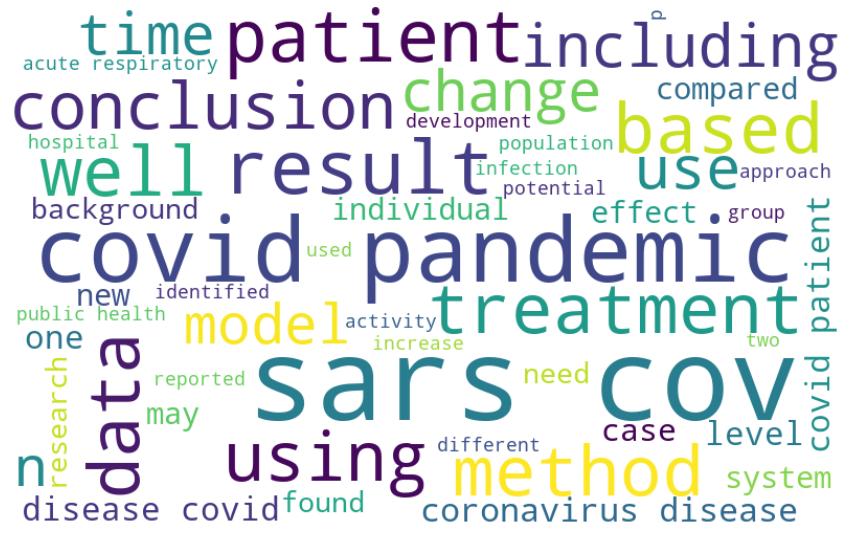

In [92]:
from wordcloud import WordCloud
from wordcloud import STOPWORDS
#We need convert all reivews to single text
all_words=' '.join([text for text in corpus])
wordcloud=WordCloud(width=800,height=500,random_state=21,max_font_size=110,max_words=50,background_color='white').generate(all_words)
plt.figure(figsize=[15,15])
plt.imshow(wordcloud, interpolation="bilinear")
plt.axis("off")
plt.show()

In [12]:
import re
df_final['abstract_updated'] = df_final['abstract'].progress_apply(lambda x: re.sub('[Cc]ovid|COVID|sars|SARS|[Pp]andemic|CoV','',x, re.IGNORECASE))

100%|██████████| 15386/15386 [00:00<00:00, 36477.92it/s]


In [13]:
from sentence_transformers import SentenceTransformer
model = SentenceTransformer('all-MiniLM-L6-v2')

Downloading:   0%|          | 0.00/1.18k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/190 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/10.6k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/612 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/116 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/39.3k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/90.9M [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/53.0 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/112 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/466k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/350 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/13.2k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/232k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/349 [00:00<?, ?B/s]

In [5]:
df_final['title_updated'] = df_final['processed_title'].progress_apply(lambda x: re.sub('[Cc]ovid|COVID|sars|SARS|[Pp]andemic|CoV','',x, re.IGNORECASE))
df_final['abstract_updated'] = df_final['processed_abstract'].progress_apply(lambda x: re.sub('[Cc]ovid|COVID|sars|SARS|[Pp]andemic|CoV','',x, re.IGNORECASE))
df_final['concated'] =  df_final['title_updated'] + df_final['abstract_updated']

KeyError: 'processed_title'

In [14]:
#Sentences are encoded by calling model.encode()
import re

df_final['title_updated'] = df_final['title'].progress_apply(lambda x: re.sub('[Cc]ovid|COVID|sars|SARS|[Pp]andemic|CoV','',x, re.IGNORECASE))
df_final['title_updated'].equals(df_final['title'])

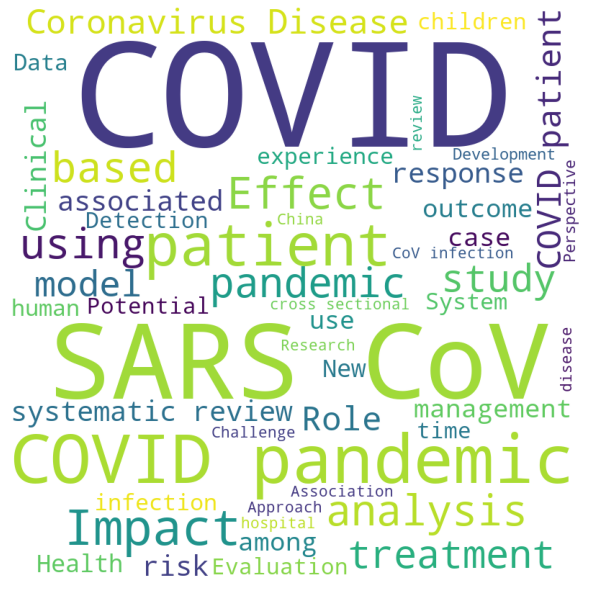

In [93]:
from wordcloud import WordCloud, STOPWORDS
import matplotlib.pyplot as plt

sentences = list(df_final['title'])

stopwords = set(STOPWORDS)
comment_words = ''
# iterate through the csv file
for val in sentences:
    # split the value
    tokens = val.split()
     
    # Converts each token into lowercase
    for i in range(len(tokens)):
        tokens[i] = tokens[i]
     
    comment_words += " ".join(tokens)+" "

    
wordcloud = WordCloud(width = 800, height = 800,
                      background_color ='white',
                      stopwords = stopwords,
                      max_words=50,
                      min_font_size = 10).generate(comment_words)
 
# plot the WordCloud image                      
plt.figure(figsize = (8, 8), facecolor = None)
plt.imshow(wordcloud)
plt.axis("off")
plt.tight_layout(pad = 0)
plt.show()

In [15]:
from umap import UMAP
from sklearn.cluster import MiniBatchKMeans
from sklearn.metrics import silhouette_score
from tqdm import tqdm

In [89]:
sentences = list(df_final['concated'])
embeddings = model.encode(sentences, show_progress_bar=True)

best_params = []

for neigh in [10, 25, 50]:
    for comp in [10, 25, 50]:
        print(f'comp: {comp} -- neigh: {neigh}')
        fit = UMAP(
            n_neighbors=neigh,
            n_components=comp,
            metric='euclidean',
            min_dist=0.05
        )
        X = fit.fit_transform(embeddings)
        
        silh_scores = {}
        for clus in tqdm(range(5, 30)):
            kmeans_model = MiniBatchKMeans(n_clusters=clus, 
                                           random_state=369).fit(X)
            labels = kmeans_model.labels_
            silh_scores[clus] = silhouette_score(X, labels, metric='euclidean')
            
        best_silh_k = max(silh_scores, key= lambda x: silh_scores[x])
        
        best_params.append({'comp': comp, 'neigh': neigh, 'best_k': best_silh_k, 'silh_score': silh_scores[best_silh_k]})

Batches:   0%|          | 0/481 [00:00<?, ?it/s]

comp: 10 -- neigh: 10


100%|██████████| 25/25 [01:41<00:00,  4.08s/it]


comp: 25 -- neigh: 10


100%|██████████| 25/25 [01:44<00:00,  4.18s/it]


comp: 50 -- neigh: 10


100%|██████████| 25/25 [01:48<00:00,  4.35s/it]


comp: 10 -- neigh: 25


100%|██████████| 25/25 [01:41<00:00,  4.08s/it]


comp: 25 -- neigh: 25


100%|██████████| 25/25 [01:44<00:00,  4.17s/it]


comp: 50 -- neigh: 25


100%|██████████| 25/25 [01:47<00:00,  4.32s/it]


comp: 10 -- neigh: 50


100%|██████████| 25/25 [01:44<00:00,  4.17s/it]


comp: 25 -- neigh: 50


100%|██████████| 25/25 [01:44<00:00,  4.18s/it]


comp: 50 -- neigh: 50


100%|██████████| 25/25 [01:48<00:00,  4.35s/it]


In [68]:
best_params

[{'comp': 10, 'neigh': 10, 'best_k': 22, 'silh_score': 0.33751422},
 {'comp': 25, 'neigh': 10, 'best_k': 29, 'silh_score': 0.3369087},
 {'comp': 50, 'neigh': 10, 'best_k': 27, 'silh_score': 0.3396824},
 {'comp': 10, 'neigh': 25, 'best_k': 29, 'silh_score': 0.32668054},
 {'comp': 25, 'neigh': 25, 'best_k': 24, 'silh_score': 0.32414964},
 {'comp': 50, 'neigh': 25, 'best_k': 26, 'silh_score': 0.32457444},
 {'comp': 10, 'neigh': 50, 'best_k': 5, 'silh_score': 0.33206147},
 {'comp': 25, 'neigh': 50, 'best_k': 5, 'silh_score': 0.32674518},
 {'comp': 50, 'neigh': 50, 'best_k': 5, 'silh_score': 0.32898107}]

In [82]:
k = 27
fit = UMAP(
    n_neighbors=10,
    n_components=50,
    metric='euclidean',
    min_dist=0.05
)
X = fit.fit_transform(embeddings)
kmeans_model = MiniBatchKMeans(n_clusters=k, random_state=369).fit(X)
y_pred = kmeans_model.fit_predict(X)

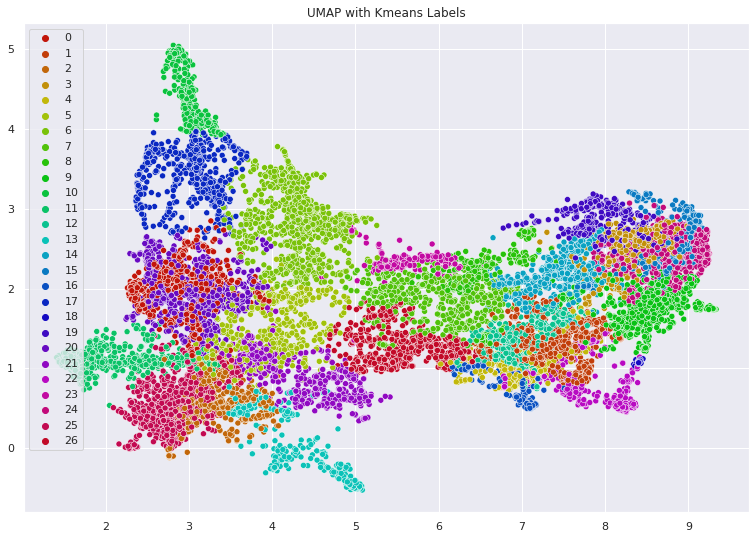

In [86]:
%matplotlib inline
from matplotlib import pyplot as plt
import seaborn as sns

# sns settings
sns.set(rc={'figure.figsize':(13,9)})

# colors
palette = sns.hls_palette(k, l=.4, s=.9)

# plot
sns.scatterplot(X[:,0], X[:,1], hue=y_pred, legend='full', palette=palette)
plt.title('UMAP with Kmeans Labels')
plt.show()

In [37]:
!pip install bertopic

huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 103.9/103.9 kB 339.4 kB/s eta 0:00:0000:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 636.6/636.6 kB 1.4 MB/s eta 0:00:00a 0:00:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.2/5.2 MB 8.6 MB/s eta 0:00:0000:01m0:01
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Created wheel for hdbscan: filename=hdbscan-0.8.29-cp37-cp37m-linux_x86_64.whl size=3426730 sha256=288381e1e97a51f36d4b78c73135d0a1edbb20597d774de13ddf26aa09aa5497
  Stored in directory: /root/.cache/pip/wheels/93/78/2e/03ee191669a772e9653260aa3bd53e0b1a768751a9676e8c82

In [87]:
from bertopic import BERTopic

topic_model = BERTopic(embedding_model=model, 
                      umap_model=UMAP(
                            n_neighbors=10,
                            n_components=50,
                            metric='euclidean',
                            min_dist=0.05
                      ),
                      hdbscan_model=MiniBatchKMeans(n_clusters=k, random_state=369),
                      diversity=0.5,
                      verbose=True).fit(sentences, embeddings)

2023-02-12 09:23:50,106 - BERTopic - Reduced dimensionality
2023-02-12 09:23:50,286 - BERTopic - Clustered reduced embeddings


In [90]:
topic_model.visualize_documents(sentences, embeddings=embeddings)

In [88]:
topic_model.visualize_barchart(top_n_topics=-1)

In [62]:
topic_model.visualize_heatmap()
